## Camera calibration

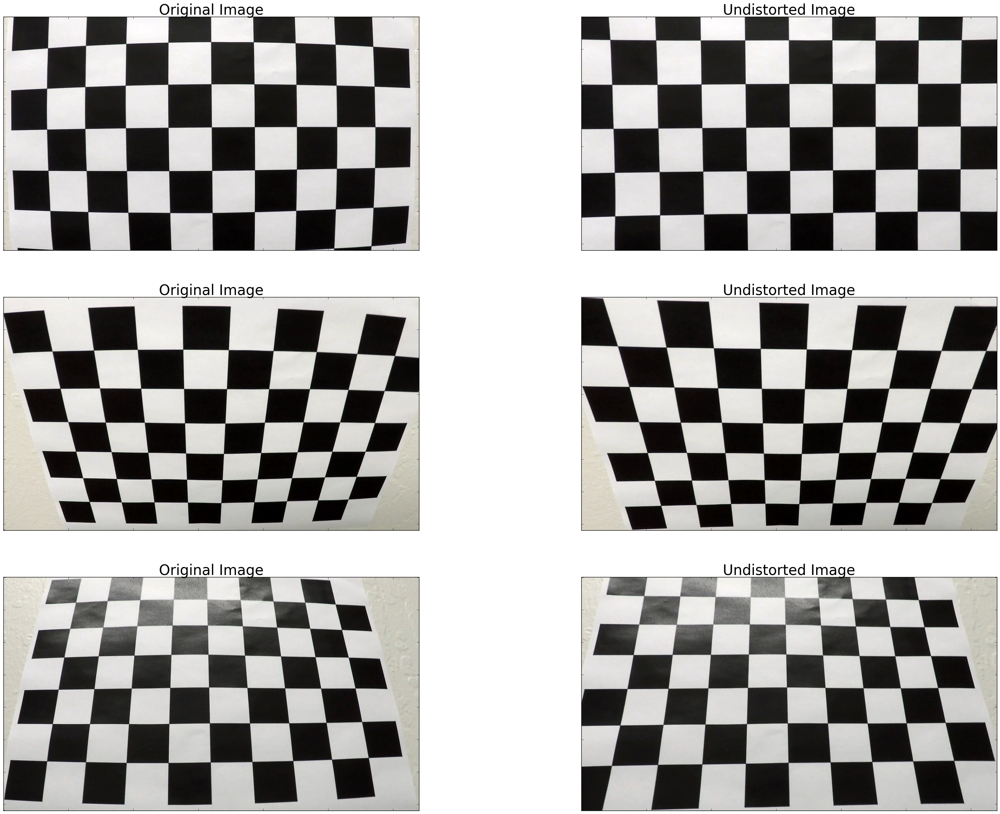

In [1]:
import os
import numpy as np
import cv2
import matplotlib
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

# prepare object points
nx = 9#TODO: enter the number of inside corners in x
ny = 6#TODO: enter the number of inside corners in y

objpoints = []
imgpoints = []
calib_mtx = []
calib_dist = []

folder = './camera_cal/'
for subdir, dirs, files in os.walk(folder):
    for file in files:
        img = plt.imread(folder + file)
        gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
        ret, corners = cv2.findChessboardCorners(gray, (nx, ny), None)
        if ret == True:
            obj = np.zeros((nx * ny, 3), np.float32)
            obj[:,:2] = np.mgrid[0:nx, 0:ny].T.reshape(-1, 2)
            objpoints.append(obj)
            imgpoints.append(corners)

ret, calib_mtx, calib_dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, img.shape[0:2], None, None)

f, axarr = plt.subplots(3, 2, figsize=(40, 30))
for i in range(3):
    file = "calibration{0}.jpg".format(i+1)
    img = plt.imread(folder + file)
    axarr[i][0].imshow(img)
    axarr[i][0].set_title('Original Image', fontsize=30)
    undist = cv2.undistort(img, calib_mtx, calib_dist, None, calib_mtx)
    axarr[i][1].imshow(undist)
    axarr[i][1].set_title('Undistorted Image', fontsize=30)
    plt.setp(axarr[i][0].get_xticklabels(), visible=False)
    plt.setp(axarr[i][0].get_yticklabels(), visible=False)
    plt.setp(axarr[i][1].get_xticklabels(), visible=False)
    plt.setp(axarr[i][1].get_yticklabels(), visible=False)
plt.show()

## Distortion correction

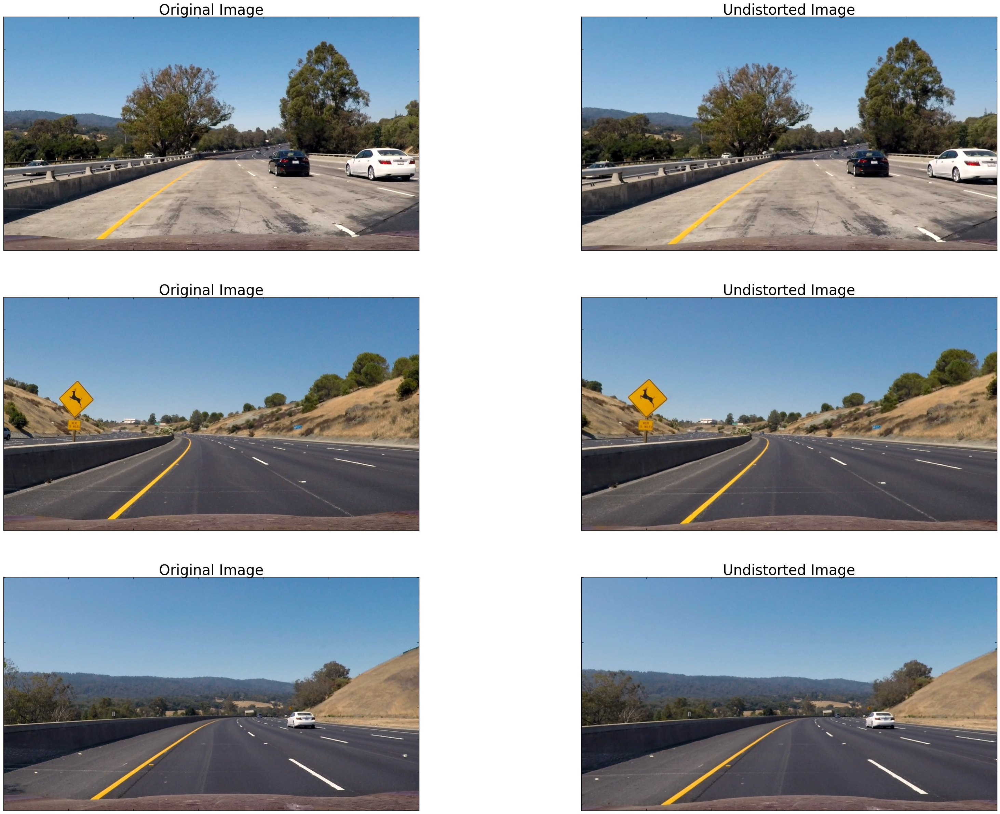

In [2]:
def undistort(image):
    undist = cv2.undistort(image, calib_mtx, calib_dist, None, calib_mtx)
    return undist

folder = "./test_images/"
f, axarr = plt.subplots(3, 2, figsize=(40, 30))
for i in range(3):
    file = "test{0}.jpg".format(i+1)
    img = plt.imread(folder + file)
    axarr[i][0].imshow(img)
    axarr[i][0].set_title('Original Image', fontsize=30)
    undist = undistort(img)
    axarr[i][1].imshow(undist)
    axarr[i][1].set_title('Undistorted Image', fontsize=30)
    plt.setp(axarr[i][0].get_xticklabels(), visible=False)
    plt.setp(axarr[i][0].get_yticklabels(), visible=False)
    plt.setp(axarr[i][1].get_xticklabels(), visible=False)
    plt.setp(axarr[i][1].get_yticklabels(), visible=False)
plt.show()

## Color transform

In [12]:
from IPython.html import widgets
from IPython.html.widgets import interact
from IPython.display import display

# crop image
def crop(image, max_row):
    image = image[0:max_row,:,:]
    return image

# convert and selected channel
def select_channel(image):
    converted = cv2.cvtColor(image, cv2.COLOR_RGB2HLS)
    filtered = converted[:,:,2]
    return filtered

# histogram equalization
def hist_equal(image):
    equal = cv2.equalizeHist(image)
    return equal

def rgb_min_bin(image, rgb):
    filtered = cv2.inRange(image, np.array(rgb), np.array([255,255,255])) / 255
    return filtered

def abs_sobel_bin(image, kernel, min_th, max_th, orient):
    if orient == 'x':
        abs_sobel = np.absolute(cv2.Sobel(image, cv2.CV_64F, 1, 0, ksize=kernel))
    if orient == 'y':
        abs_sobel = np.absolute(cv2.Sobel(image, cv2.CV_64F, 0, 1, ksize=kernel))
    scaled_sobel = np.uint8(255*abs_sobel/np.max(abs_sobel))
    binary_output = np.zeros_like(scaled_sobel)
    binary_output[(scaled_sobel >= min_th) & (scaled_sobel <= max_th)] = 1
    return binary_output

# sobel gradient magnitude binary
def sobel_grad_mag_bin(image, kernel, min_th, max_th):
    sobelx = cv2.Sobel(image, cv2.CV_64F, 1, 0, ksize=kernel)
    sobely = cv2.Sobel(image, cv2.CV_64F, 0, 1, ksize=kernel)
    gradmag = np.sqrt(sobelx**2 + sobely**2)
    scale_factor = np.max(gradmag)/255
    gradmag = (gradmag/scale_factor).astype(np.uint8)
    binary_output = np.zeros_like(gradmag)
    binary_output[(gradmag >= min_th) & (gradmag <= max_th)] = 1
    return binary_output

def sobel_grad_dir_bin(image, kernel, min_th, max_th):
    sobelx = cv2.Sobel(image, cv2.CV_64F, 1, 0, ksize=kernel)
    sobely = cv2.Sobel(image, cv2.CV_64F, 0, 1, ksize=kernel)
    absgraddir = np.arctan2(np.absolute(sobely), np.absolute(sobelx))
    binary_output =  np.zeros_like(absgraddir)
    binary_output[(absgraddir >= min_th) & (absgraddir <= max_th)] = 1
    return binary_output


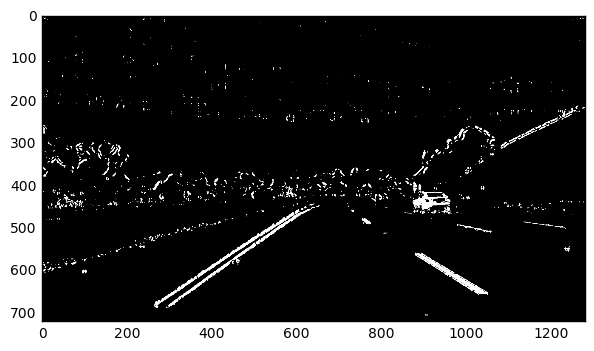

In [15]:

def disp_color_trans(file_idx, r_min, g_min, b_min, sobel_kernel, sobel_abs_x_min, sobel_abs_x_max, 
                     sobel_abs_y_min, sobel_abs_y_max, sobel_mag_min, sobel_mag_max, sobel_dir_min, sobel_dir_max):
    file = "./test_images/test{0}.jpg".format(file_idx)
    image = plt.imread(file)
    rgb_bin = rgb_min_bin(image, [r_min, g_min, b_min])
    image = select_channel(image)
    image = hist_equal(image)
    gradx = abs_sobel_bin(image, sobel_kernel, sobel_abs_x_min, sobel_abs_x_max, 'x')
    grady = abs_sobel_bin(image, sobel_kernel, sobel_abs_y_min, sobel_abs_y_max, 'y')
    mag_bin = sobel_grad_mag_bin(image, sobel_kernel, sobel_mag_min, sobel_mag_max)
    dir_bin = sobel_grad_dir_bin(image, sobel_kernel, sobel_dir_min, sobel_dir_max)
    combined = np.zeros_like(dir_bin)
    combined[((rgb_bin == 1) | (gradx == 1) & (grady == 1)) | ((mag_bin == 1) & (dir_bin == 1))] = 1
    plt.figure(figsize=(7,7))
    plt.imshow(combined, cmap='gray') 
    plt.show()

interact(disp_color_trans, file_idx=(1,6),
         r_min=(0,255), g_min=(0,255), b_min=(0,255),
         sobel_kernel=(1,31,2), 
         sobel_abs_x_min=(0,255), sobel_abs_x_max=(0,255),
         sobel_abs_y_min=(0,255), sobel_abs_y_max=(0,255),
         sobel_mag_min=(0,255), sobel_mag_max=(0,255),
         sobel_dir_min=(0,np.pi/2), sobel_dir_max=(0,np.pi/2));


In [19]:
# result
sobel_kernel = 11
r_min = 190
g_min = 190
b_min = 190
sobel_abs_x_min = 42
sobel_abs_x_max = 110
sobel_abs_y_min = 42
sobel_abs_y_max = 110
sobel_mag_min = 48
sobel_mag_max = 216
sobel_dir_min = 0.1
sobel_dir_max = 1.2

def color_transform(image):
    rgb_bin = rgb_min_bin(image, [r_min, g_min, b_min])
    image = select_channel(image)
    image = hist_equal(image)
    gradx = abs_sobel_bin(image, sobel_kernel, sobel_abs_x_min, sobel_abs_x_max, 'x')
    grady = abs_sobel_bin(image, sobel_kernel, sobel_abs_y_min, sobel_abs_y_max, 'y')
    mag_bin = sobel_grad_mag_bin(image, sobel_kernel, sobel_mag_min, sobel_mag_max)
    dir_bin = sobel_grad_dir_bin(image, sobel_kernel, sobel_dir_min, sobel_dir_max)
    combined = np.zeros_like(dir_bin)
    combined[(rgb_bin == 1) | ((gradx == 1) & (grady == 1)) | ((mag_bin == 1) & (dir_bin == 1))] = 1
    return combined


## Perspective transform

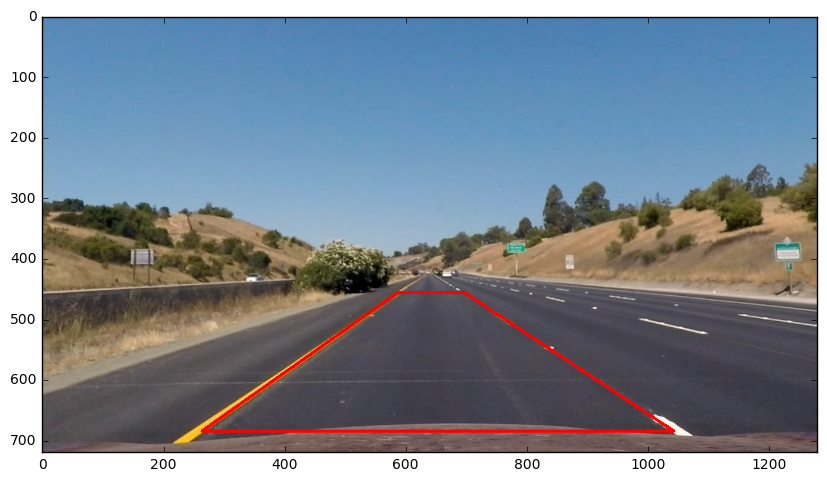

In [6]:
def disp_straight_line(file_idx, min_x1, min_x2, max_x1, max_x2, min_y, max_y):
    file = "./test_images/straight_lines{0}.jpg".format(file_idx)
    image = plt.imread(file)
    image = undistort(image)
    cv2.line(image, (min_x1,max_y),(min_x2,min_y), 
                  color=(255,0,0), thickness=4, lineType=8, shift=0);
    cv2.line(image, (min_x2,min_y),(max_x1,min_y),
                  color=(255,0,0), thickness=4, lineType=8, shift=0);
    cv2.line(image, (max_x1,min_y),(max_x2,max_y), 
                  color=(255,0,0), thickness=4, lineType=8, shift=0);
    cv2.line(image, (min_x1,max_y),(max_x2,max_y), 
                  color=(255,0,0), thickness=4, lineType=8, shift=0);
    plt.figure(figsize=(10,10))
    plt.imshow(image, cmap='gray')
    plt.show()

interact(disp_straight_line, file_idx=(1,2), min_x1=(0,640), min_x2=(0,640), 
         max_x1=(640,1280), max_x2=(640,1280), min_y=(200, 540), max_y=(540, 720));


In [17]:
# result: 243, 587, 696, 1071, 450, 685

src_min_x1 = 263
src_min_x2 = 587
src_max_x1 = 696
src_max_x2 = 1042
src_min_y = 456
src_max_y = 685

dst_min_x = 320
dst_max_x = 960
dst_min_y = 20
dst_max_y = 700

src_points = np.float32([[src_min_x1,src_max_y], 
                         [src_min_x2,src_min_y], 
                         [src_max_x1,src_min_y], 
                         [src_max_x2,src_max_y]])
dst_points = np.float32([[dst_min_x,dst_max_y], 
                         [dst_min_x,dst_min_y], 
                         [dst_max_x,dst_min_y], 
                         [dst_max_x,dst_max_y]])

persp_mtx = cv2.getPerspectiveTransform(src_points, dst_points)
persp_inv_mtx = cv2.getPerspectiveTransform(dst_points, src_points)

def warp(image):
    warped = cv2.warpPerspective(image, persp_mtx, (image.shape[1],image.shape[0]))
    return warped
    
def unwarp(image):
    unwarped = cv2.warpPerspective(image, persp_inv_mtx, (image.shape[1],image.shape[0]))
    return unwarped


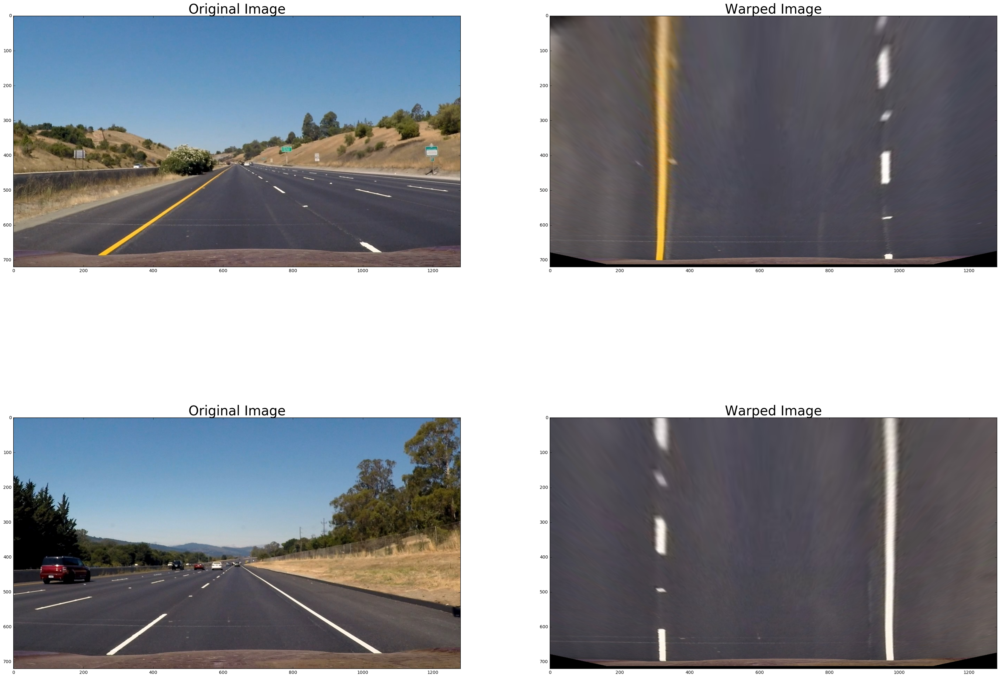

In [8]:

folder = "./test_images/"
f, axarr = plt.subplots(2, 2, figsize=(40, 30))
for i in range(2):
    file = "straight_lines{0}.jpg".format(i+1)
    img = plt.imread(folder + file)
    axarr[i][0].imshow(img)
    axarr[i][0].set_title('Original Image', fontsize=30)
    warped = warp(img)
    axarr[i][1].imshow(warped)
    axarr[i][1].set_title('Warped Image', fontsize=30)
plt.show()


## Lane detection

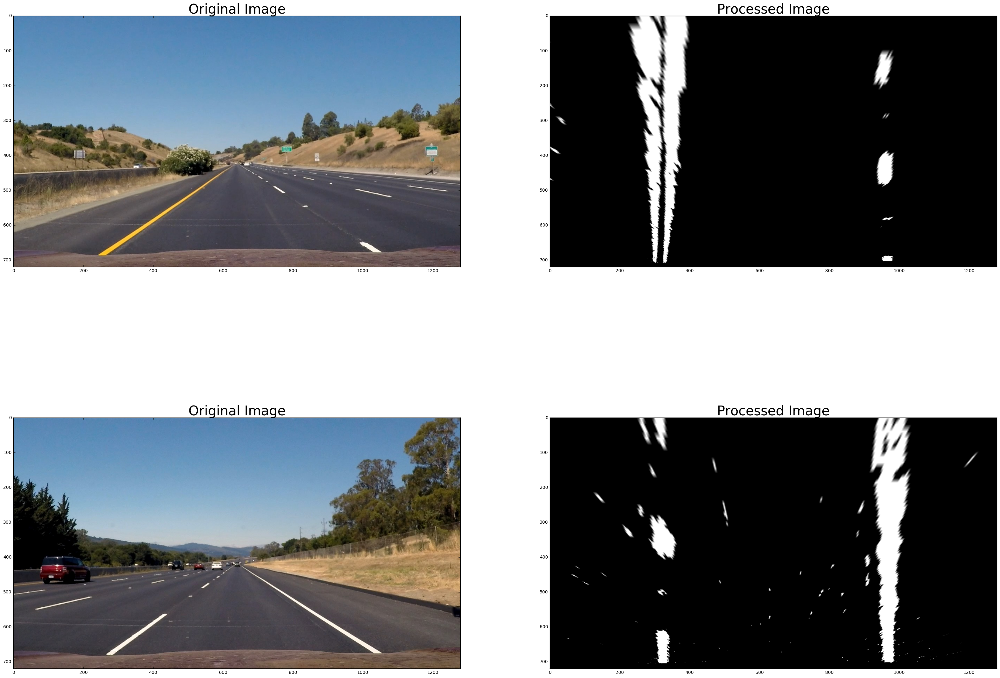

In [21]:

folder = "./test_images/"
f, axarr = plt.subplots(2, 2, figsize=(40, 30))
for i in range(2):
    file = "straight_lines{0}.jpg".format(i+1)
    image = plt.imread(folder + file)
    axarr[i][0].imshow(image)
    axarr[i][0].set_title('Original Image', fontsize=30)
    undist = undistort(image)
    transf = color_transform(undist)
    warped = warp(transf)
    axarr[i][1].imshow(warped, cmap='gray')
    axarr[i][1].set_title('Processed Image', fontsize=30)
plt.show()


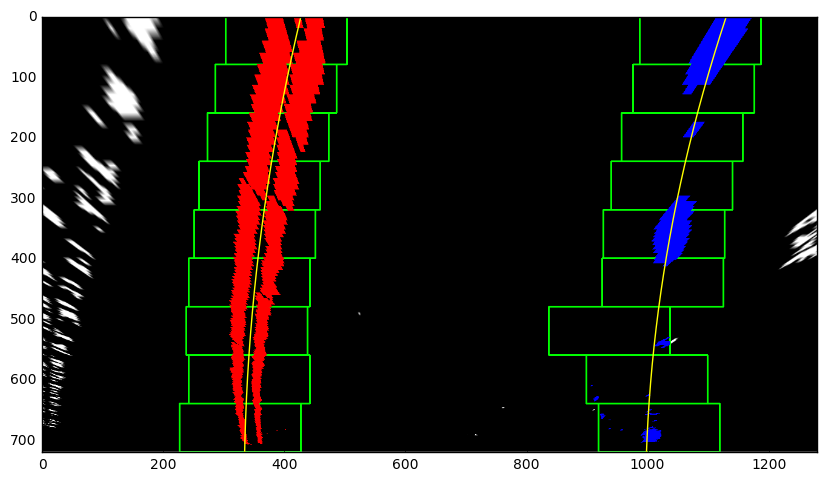

In [22]:
folder = "./test_images/"
file = "test1.jpg"
image = plt.imread(folder + file)
undist = undistort(image)
transf = color_transform(undist)
binary_warped = warp(transf)
out_img = np.dstack((binary_warped, binary_warped, binary_warped))

# find base
histogram = np.sum(binary_warped[np.int(binary_warped.shape[0]/2):,:], axis=0)
midpoint = np.int(histogram.shape[0]/2)
leftx_base = np.argmax(histogram[:midpoint])
rightx_base = np.argmax(histogram[midpoint:]) + midpoint

nwindows = 9
margin = 100
minpix = 50

# get indices
window_height = np.int(binary_warped.shape[0]/nwindows)
nonzero = binary_warped.nonzero()
nonzeroy = np.array(nonzero[0])
nonzerox = np.array(nonzero[1])
leftx_current = leftx_base
rightx_current = rightx_base
left_lane_inds = []
right_lane_inds = []
for window in range(nwindows):
    win_y_low = binary_warped.shape[0] - (window+1)*window_height
    win_y_high = binary_warped.shape[0] - window*window_height
    win_xleft_low = leftx_current - margin
    win_xleft_high = leftx_current + margin
    win_xright_low = rightx_current - margin
    win_xright_high = rightx_current + margin
    
    # draw rect
    cv2.rectangle(out_img,(win_xleft_low,win_y_low),(win_xleft_high,win_y_high),(0,1,0), 2) 
    cv2.rectangle(out_img,(win_xright_low,win_y_low),(win_xright_high,win_y_high),(0,1,0), 2)
        
    good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & (nonzerox >= win_xleft_low) & (nonzerox < win_xleft_high)).nonzero()[0]
    good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & (nonzerox >= win_xright_low) & (nonzerox < win_xright_high)).nonzero()[0]
    left_lane_inds.append(good_left_inds)
    right_lane_inds.append(good_right_inds)
    
    if len(good_left_inds) > minpix:
        leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
    if len(good_right_inds) > minpix:        
        rightx_current = np.int(np.mean(nonzerox[good_right_inds]))
        
left_lane_inds = np.concatenate(left_lane_inds)
right_lane_inds = np.concatenate(right_lane_inds)

# left and right line pixel positions
leftx = nonzerox[left_lane_inds]
lefty = nonzeroy[left_lane_inds] 
rightx = nonzerox[right_lane_inds]
righty = nonzeroy[right_lane_inds]

# left and right line polyfit
left_fit = np.polyfit(lefty, leftx, 2)
right_fit = np.polyfit(righty, rightx, 2)

histogram = np.sum(binary_warped[np.int(binary_warped.shape[0]/2):,:], axis=0)
midpoint = np.int(histogram.shape[0]/2)
leftx_base = np.argmax(histogram[:midpoint])
rightx_base = np.argmax(histogram[midpoint:]) + midpoint

# draw line
ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]

out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [1, 0, 0]
out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 1]
plt.figure(figsize=(10,10))
plt.imshow(out_img)
plt.plot(left_fitx, ploty, color='yellow')
plt.plot(right_fitx, ploty, color='yellow')
plt.xlim(0, 1280)
plt.ylim(720, 0)

plt.show()

In [23]:
fit_nwindows = 9
fit_margin = 100
fit_minpix = 50
ym_per_pix = 30/720 # meters per pixel in y dimension
xm_per_pix = 3.7/700 # meters per pixel in x dimension

def find_base_pos(bin_img):
    histogram = np.sum(bin_img[np.int(bin_img.shape[0]/2):,:], axis=0)
    midpoint = np.int(histogram.shape[0]/2)
    leftx_base = np.argmax(histogram[:midpoint])
    rightx_base = np.argmax(histogram[midpoint:]) + midpoint
    return leftx_base, rightx_base

def bin_to_color(bin_img, channel):
    n = -1
    if channel == 'r':
        n = 0
    elif channel == 'g':
        n = 1
    elif channel == 'b':
        n = 2
    color_img = np.zeros((bin_img.shape[0], bin_img.shape[1], 3))
    scaled = bin_img * 255
    color_img[:,:,n] = scaled
    return color_img.astype(np.uint8)

def blind_fitting(bin_img, leftx_base, rightx_base):
    window_height = np.int(bin_img.shape[0]/fit_nwindows)
    nonzero = bin_img.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    leftx_current = leftx_base
    rightx_current = rightx_base
    image_x_size = bin_img.shape[1]
    image_y_size = bin_img.shape[0]
    left_lane_inds = []
    right_lane_inds = []
    for window in range(fit_nwindows):
        win_y_low = image_y_size - (window+1)*window_height
        win_y_high = image_y_size - window*window_height
        win_xleft_low = leftx_current - fit_margin
        win_xleft_high = leftx_current + fit_margin
        win_xright_low = rightx_current - fit_margin
        win_xright_high = rightx_current + fit_margin
        good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & (nonzerox >= win_xleft_low) & (nonzerox < win_xleft_high)).nonzero()[0]
        good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & (nonzerox >= win_xright_low) & (nonzerox < win_xright_high)).nonzero()[0]
        left_lane_inds.append(good_left_inds)
        right_lane_inds.append(good_right_inds)
        if len(good_left_inds) > fit_minpix:
            leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
        if len(good_right_inds) > fit_minpix:        
            rightx_current = np.int(np.mean(nonzerox[good_right_inds]))
    left_lane_inds = np.concatenate(left_lane_inds)
    right_lane_inds = np.concatenate(right_lane_inds)
    # left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds] 
    # left and right line polyfit
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)
    return left_fit, right_fit, leftx, lefty, rightx, righty

def update_fitting(bin_img, left_fit, right_fit):
    nonzero = bin_img.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    image_x_size = bin_img.shape[1]
    image_y_size = bin_img.shape[0]
    left_lane_inds = ((nonzerox > (left_fit[0]*(nonzeroy**2) + left_fit[1]*nonzeroy + left_fit[2] - fit_margin)) & (nonzerox < (left_fit[0]*(nonzeroy**2) + left_fit[1]*nonzeroy + left_fit[2] + fit_margin))) 
    right_lane_inds = ((nonzerox > (right_fit[0]*(nonzeroy**2) + right_fit[1]*nonzeroy + right_fit[2] - fit_margin)) & (nonzerox < (right_fit[0]*(nonzeroy**2) + right_fit[1]*nonzeroy + right_fit[2] + fit_margin)))  
    # left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]
    # left and right line polyfit
    new_left_fit = np.polyfit(lefty, leftx, 2)
    new_right_fit = np.polyfit(righty, rightx, 2)
    return new_left_fit, new_right_fit, leftx, lefty, rightx, righty

def lane_image(shape, left_fit, right_fit):
    image_y_size = shape[0]
    lane_img = np.zeros(shape)
    ploty = np.linspace(0, image_y_size-1, image_y_size)
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    for row in range(shape[0]):
        for col in range(max(0,np.int(left_fitx[row])), min(shape[1],np.int(right_fitx[row]))):
            lane_img[row][col] = 1
    return lane_img

def calc_curvature(shape, leftx, lefty, rightx, righty):
    image_y_size = shape[0]
    left_fit_cr = np.polyfit(lefty*ym_per_pix, leftx*xm_per_pix, 2)
    right_fit_cr = np.polyfit(righty*ym_per_pix, rightx*xm_per_pix, 2)
#     left_curverad = ((1 + (2*left_fit_cr[0]*image_y_size*ym_per_pix + left_fit_cr[1])**2)**1.5) / np.absolute(2*left_fit_cr[0])
#     right_curverad = ((1 + (2*right_fit_cr[0]*image_y_size*ym_per_pix + right_fit_cr[1])**2)**1.5) / np.absolute(2*right_fit_cr[0])
    left_curverad = ((1 + (2*left_fit_cr[0]*image_y_size*ym_per_pix + left_fit_cr[1])**2)**1.5) / (2*left_fit_cr[0])
    right_curverad = ((1 + (2*right_fit_cr[0]*image_y_size*ym_per_pix + right_fit_cr[1])**2)**1.5) / (2*right_fit_cr[0])
    return left_curverad, right_curverad

def calc_position(shape, left_fit, right_fit):
    image_x_size = shape[1]
    image_y_size = shape[0]
    fit_leftx_base = left_fit[0]*image_y_size**2 + left_fit[1]*image_y_size + left_fit[2]
    fit_rightx_base = right_fit[0]*image_y_size**2 + right_fit[1]*image_y_size + right_fit[2]
    x_offset = ((fit_leftx_base + fit_rightx_base)/2 - image_x_size/2 ) * xm_per_pix
    return x_offset, fit_leftx_base, fit_rightx_base


## Lane curvature and vehicle position

left curve rad:  1085.69623865
right curve rad:  802.502204542
x offset 0.138605952671
left curve rad:  -508.819449478
right curve rad:  -1485.09578288
x offset 0.344428181753
left curve rad:  3955.57424076
right curve rad:  497.837397159
x offset 0.111415003823


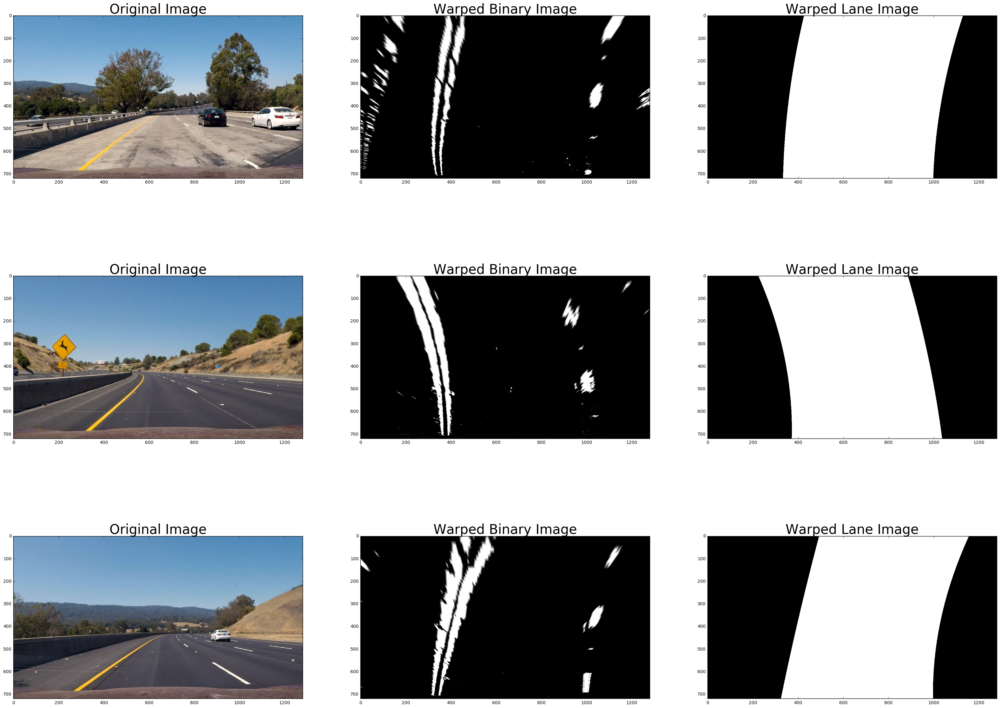

In [24]:

folder = "./test_images/"
f, axarr = plt.subplots(3, 3, figsize=(40, 30))
for i in range(3):
    file = "test{0}.jpg".format(i+1)
    image = plt.imread(folder + file)
    undist = undistort(image)
    transf = color_transform(undist)
    bin_warped = warp(transf)
    leftx_base, rightx_base = find_base_pos(bin_warped)
    left_fit, right_fit, leftx, lefty, rightx, righty = blind_fitting(bin_warped, leftx_base, rightx_base)
    left_curverad, right_curverad = calc_curvature(bin_warped.shape, leftx, lefty, rightx, righty)
    x_offset, _, _ = calc_position(bin_warped.shape, left_fit, right_fit)
    lane_img = lane_image(bin_warped.shape, left_fit, right_fit)
    print("left curve rad: ", left_curverad)
    print("right curve rad: ", right_curverad)
    print("x offset", x_offset)
    axarr[i][0].imshow(image)
    axarr[i][0].set_title('Original Image', fontsize=30)
    axarr[i][1].imshow(bin_warped, cmap='gray')
    axarr[i][1].set_title('Warped Binary Image', fontsize=30)
    axarr[i][2].imshow(lane_img, cmap='gray')
    axarr[i][2].set_title('Warped Lane Image', fontsize=30)
plt.show()


## Lane warping back onto the original image

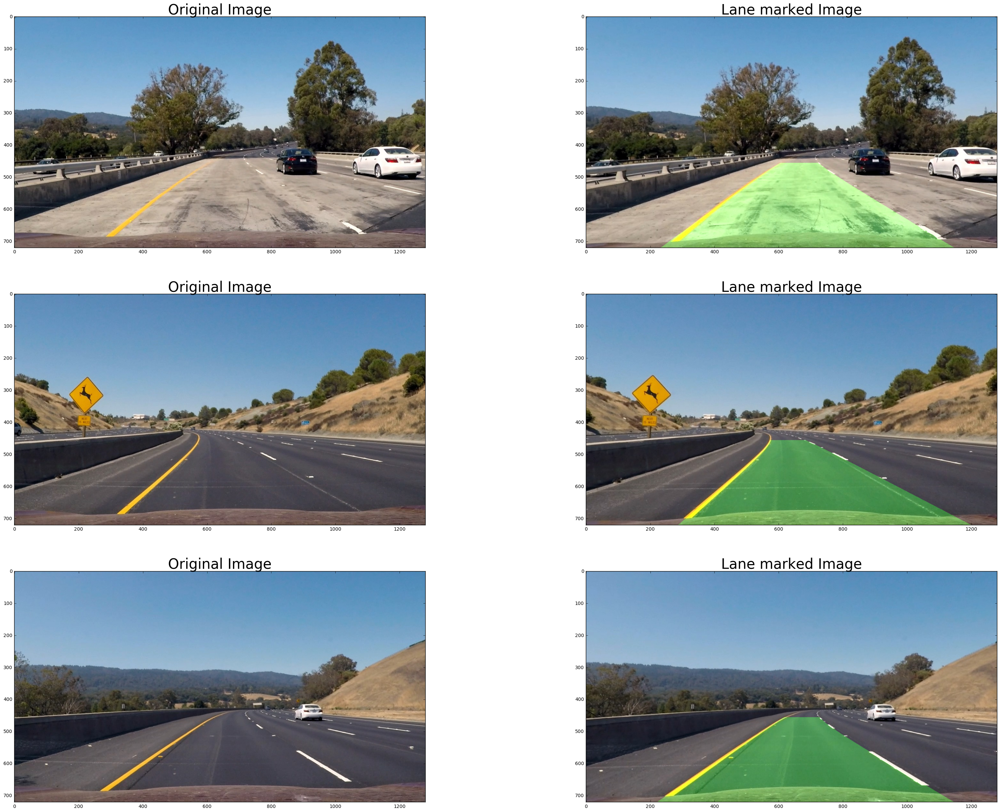

In [25]:

folder = "./test_images/"
f, axarr = plt.subplots(3, 2, figsize=(40, 30))
for i in range(3):
    file = "test{0}.jpg".format(i+1)
    image = plt.imread(folder + file)
    undist = undistort(image)
    transf = color_transform(undist)
    bin_warped = warp(transf)
    leftx_base, rightx_base = find_base_pos(bin_warped)
    left_fit, right_fit, leftx, lefty, rightx, righty = blind_fitting(bin_warped, leftx_base, rightx_base)
    left_curverad, right_curverad = calc_curvature(bin_warped.shape, leftx, lefty, rightx, righty)
    x_offset, _, _ = calc_position(bin_warped.shape, left_fit, right_fit)
    lane_bin_img = lane_image(bin_warped.shape, left_fit, right_fit)
    lane_bin_unwarped = unwarp(lane_bin_img)
    lane_colored = bin_to_color(lane_bin_unwarped, 'g')
    result = cv2.addWeighted(undist, 1.0, lane_colored, 0.3, 0)
    
    axarr[i][0].imshow(image)
    axarr[i][0].set_title('Original Image', fontsize=30)
    axarr[i][1].imshow(result)
    axarr[i][1].set_title('Lane marked Image', fontsize=30)
plt.show()


## Visualization of lane boundary, curvature and vehicle position (with sanity check)

In [26]:

# Import everything needed to edit/save/watch video clips
from moviepy.editor import VideoFileClip
from IPython.display import HTML


In [27]:
prev_left_fit = []
prev_right_fit = []
# prev_leftx = []
# prev_lefty = []
prev_left_curverad = 0
# prev_rightx = []
# prev_righty = []
prev_right_curverad = 0
curverad_thres_high = 50.0
curverad_thres_low = 0.02
curverad_f = 0.5
reset_fit = True
leftx_base = 0
rightx_base = 0
base_thres = 0.5 # meter
    
def interpolate(fit, prev_fit, curverad, prev_curverad, factor):
    f_new = factor
    f_old = 1 - factor
    new_fit = f_new * fit + f_old * prev_fit
    new_curverad = f_new * curverad + f_old * prev_curverad
    return new_fit, new_curverad

def process_image(image):
    global reset_fit, prev_left_fit, prev_right_fit, prev_left_curverad, prev_right_curverad, leftx_base, rightx_base
    shape = image.shape
    undist = undistort(image)
    transf = color_transform(undist)
    bin_warped = warp(transf)
    if reset_fit == True: # blind fitting
        leftx_base, rightx_base = find_base_pos(bin_warped)
        left_fit, right_fit, leftx, lefty, rightx, righty = blind_fitting(bin_warped, leftx_base, rightx_base)
        left_curverad, right_curverad = calc_curvature(bin_warped.shape, leftx, lefty, rightx, righty)
        prev_left_fit = left_fit
        prev_right_fit = right_fit
        prev_left_curverad = left_curverad
        prev_right_curverad = right_curverad
        reset_fit = False
    else: # update fitting
        left_fit, right_fit, leftx, lefty, rightx, righty = update_fitting(bin_warped, prev_left_fit, prev_right_fit)
        left_curverad, right_curverad = calc_curvature(bin_warped.shape, leftx, lefty, rightx, righty)
        # left
        if ((abs(left_curverad - prev_left_curverad) > curverad_thres_high * abs(prev_left_curverad))
            or (abs(left_curverad - prev_left_curverad) < curverad_thres_low * abs(prev_left_curverad))): # large variation
            left_fit = prev_left_fit
            left_curverad = prev_left_curverad
        else: # update using previous result
            left_fit, left_curverad = interpolate(left_fit, prev_left_fit, left_curverad, prev_left_curverad, curverad_f)
            prev_left_fit = left_fit
            prev_left_curverad = left_curverad
        # right
        if ((abs(right_curverad - prev_right_curverad) > curverad_thres_high * abs(prev_right_curverad))
            or (abs(right_curverad - prev_right_curverad) < curverad_thres_low * abs(prev_right_curverad))): # large variation
            right_fit = prev_right_fit
            right_curverad = prev_right_curverad
        else: # update using previous result
            right_fit, right_curverad = interpolate(right_fit, prev_right_fit, right_curverad, prev_right_curverad, curverad_f)
            prev_right_fit = right_fit
            prev_right_curverad = right_curverad
    x_offset, left_base_r, right_base_r = calc_position(bin_warped.shape, left_fit, right_fit)
    reset_fit = abs(left_base_r - leftx_base * xm_per_pix) > base_thres or abs(right_base_r - rightx_base * xm_per_pix) > base_thres
    lane_bin_img = lane_image(bin_warped.shape, left_fit, right_fit)
    lane_colored = bin_to_color(lane_bin_img, 'g')
    lane_color_unwarped = unwarp(lane_colored)
    result = cv2.addWeighted(undist, 1.0, lane_color_unwarped, 0.3, 0)
    font = cv2.FONT_HERSHEY_SIMPLEX
    # result image
    cv2.putText(result,'Estimated lane curvature: {0:.2f} m'.format((abs(left_curverad) + abs(right_curverad))/2), (20,60), font, 
                fontScale=1.5, color=(255,0,0), thickness=2);
    cv2.putText(result,'Estimated offset from the lane center: {0:.2f} m'.format(x_offset), (20,120), font, 
                fontScale=1.5, color=(255,0,0), thickness=2);
#     # debug
#     cv2.putText(result,'base: {0} {1} pix'.format(leftx_base, rightx_base), (20,160), font, 
#                 fontScale=1, color=(255,0,0), thickness=2);
#     cv2.putText(result,'rad: {0} {1} m'.format(left_curverad, right_curverad), (20,200), font, 
#                 fontScale=1, color=(255,0,0), thickness=2);
#     cv2.putText(result,'left fit: {0}'.format(left_fit), (20,240), font, 
#                 fontScale=1, color=(255,0,0), thickness=2);
#     cv2.putText(result,'right fit: {0}'.format(right_fit), (20,280), font, 
#                 fontScale=1, color=(255,0,0), thickness=2);
    # aux images
    aux_size = np.int(image.shape[0]/2)
    # original image
    image = cv2.resize(image, (aux_size, aux_size))
    cv2.putText(image, 'Original', (20,40), font, fontScale=1, color=(255,0,0), thickness=2);
    # color transformed image
    transf_colored = bin_to_color(transf, 'b')
    transf_colored = cv2.resize(transf_colored, (aux_size, aux_size))
    cv2.putText(transf_colored, 'Filtered', (20,40), font, fontScale=1, color=(255,0,0), thickness=2);
    # warped binary image
    bin_warped_colored = bin_to_color(bin_warped, 'b')
    bin_warped_colored = cv2.resize(bin_warped_colored, (aux_size, aux_size))
    cv2.putText(bin_warped_colored, 'Warped', (20,40), font, fontScale=1, color=(255,0,0), thickness=2);
    # lane prediction
    lane_colored = cv2.resize(lane_colored, (aux_size, aux_size))
    cv2.putText(lane_colored, 'Lane prediction', (20,40), font, fontScale=1, color=(255,0,0), thickness=2);
    # merge images
    aux1 = np.vstack((image, transf_colored))
    aux2 = np.vstack((bin_warped_colored, lane_colored))
    output_image = np.hstack((result, aux1, aux2))
    return output_image


In [17]:
filenames = ["project_video", "challenge_video", "harder_challenge_video"]

for filename in filenames:
    input_filename = filename + ".mp4"
    output_filename = filename + "_out" + ".mp4"
    # debug_filename = filename + "debug" + ".mp4"
    input_clip = VideoFileClip(input_filename)#.subclip(0,5)
    output_clip = input_clip.fl_image(process_image)
    %time output_clip.write_videofile(output_filename, audio=False)


[MoviePy] >>>> Building video project_video_out.mp4
[MoviePy] Writing video project_video_out.mp4


100%|█████████████████████████████████████████████████████████████████████████████▉| 1260/1261 [08:57<00:00,  2.33it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: project_video_out.mp4 

Wall time: 8min 58s
[MoviePy] >>>> Building video challenge_video_out.mp4
[MoviePy] Writing video challenge_video_out.mp4


100%|████████████████████████████████████████████████████████████████████████████████| 485/485 [02:59<00:00,  2.62it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: challenge_video_out.mp4 

Wall time: 3min
[MoviePy] >>>> Building video harder_challenge_video_out.mp4
[MoviePy] Writing video harder_challenge_video_out.mp4


100%|█████████████████████████████████████████████████████████████████████████████▉| 1199/1200 [07:56<00:00,  2.27it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: harder_challenge_video_out.mp4 

Wall time: 7min 57s


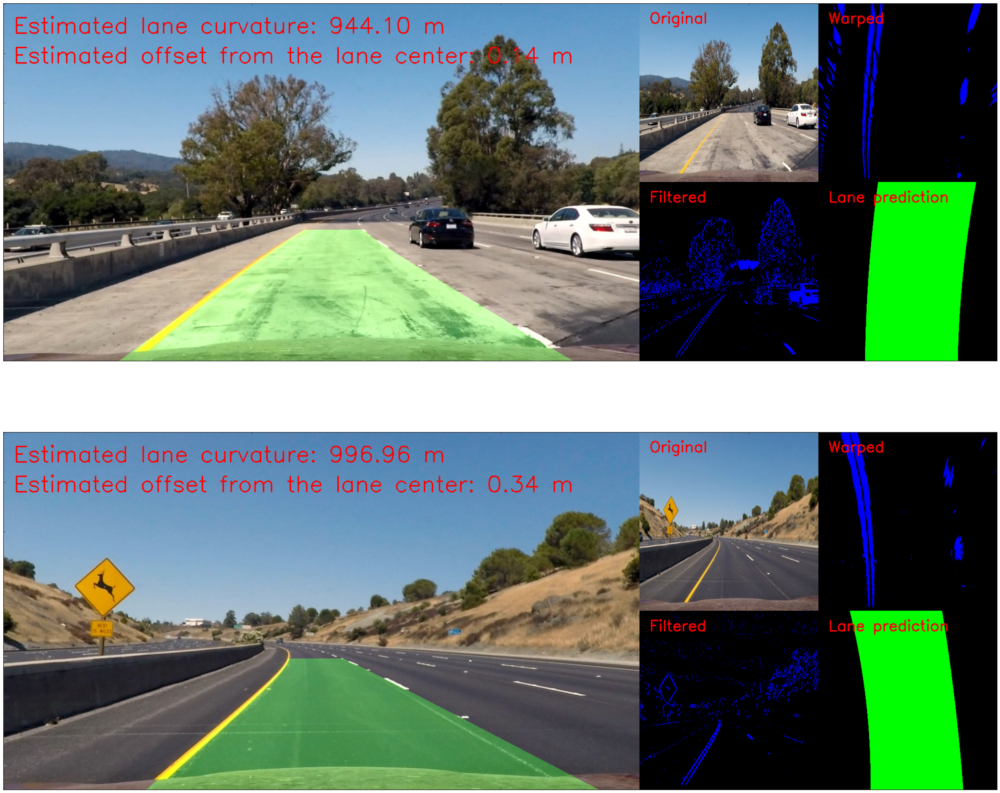

In [28]:

folder = "./test_images/"
f, axarr = plt.subplots(2, 1, figsize=(40, 30))
for i in range(2):
    file = "test{0}.jpg".format(i+1)
    image = plt.imread(folder + file)
    output = process_image(image)
    axarr[i].imshow(output)
    # axarr[i].set_title('Original Image', fontsize=30)
    plt.setp(axarr[i].get_xticklabels(), visible=False)
    plt.setp(axarr[i].get_yticklabels(), visible=False)
plt.show()
